<a href="https://colab.research.google.com/github/GianmarcoLuchetti/Bioavailability/blob/main/Scaling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploration of Scaling Process

---

**Goal →** Understand how the scaling affects the convergence of the loss during the training process. In this experiment, we will consider scaling at three different points:


1.   The original features
2.   The noise
3.   Both

The **MinMax Scaler** will be used in the following experiments

$$
x_{scaled} = \frac{x - x_{min}}{x_{max} - x_{min}} \cdot (t_{max} - t_{min}) + t_{min}
$$

where:


*   $x →$ original feature
*   $x_{max} →$ highest value of the feature
*   $x_{min} →$ lowest value of the feature
*   $t_{max} →$ highest limit of scaling range
*   $t_{max} →$ lowest limit of scaling range

## Notebook Setup

In [ ]:
# Install and import required libraries

!pip -q install pyg_lib torch_scatter torch_sparse torch_cluster torch_spline_conv -f https://data.pyg.org/whl/torch-2.3.0+cu121.html
!pip -q install torch_geometric
!pip -q install pymatgen
!pip -q install p-tqdm
!pip -q install lightning
!pip -q install diffusers
!pip -q install accelerate
!pip -q install torcheval

import sys
sys.path.append("/content/DiffMolGen/")

import pandas as pd
import torch
from torch_geometric.data import Data
from torch_geometric.utils import to_networkx
import networkx as nx
from diffmolgen.data import create_datasets
from diffusers import DDPMScheduler
from diffusers.optimization import get_cosine_schedule_with_warmup
import os
from tqdm.auto import tqdm
from abc import ABC
from torch_geometric.nn import MessagePassing
from torch.nn import Linear, ReLU, Sequential
from torch_scatter import scatter
from diffusers import ModelMixin, ConfigMixin
from matplotlib.lines import Line2D
import torch.nn.functional as F
from tqdm import tqdm
from torcheval.metrics import R2Score
from accelerate import Accelerator
import pathlib
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import pylab
from torch_geometric.loader import DataLoader
from dataclasses import dataclass
from diffmolgen.data.data_utils import ConfigBase, export_crystal

seed = torch.manual_seed(12345)

## Utils

In [ ]:
# Class to define the scaling process and the reverse

class MinMaxPipeline:
    def __init__(self, x_min, x_max, t_min=0, t_max=1):
      self.x_min = x_min
      self.x_max = x_max
      self.t_min = t_min
      self.t_max = t_max

    def scaler(self, x):
      return (x - self.x_min) / (self.x_max - self.x_min) * (self.t_max - self.t_min) + self.t_min

    def reverse_scaler(self, x):
      return (x - self.t_min) / (self.t_max - self.t_min) * (self.x_max - self.x_min) + self.x_min

In [ ]:
# Func to visualize the training process

def get_loss_map(loss_fn, x, y):
  """
  Maps the loss function
  """
  losses = [[0.0] * 101 for _ in range(101)]
  for wi in range(101):
    for wb in range(101):
      w = -0.050 + 0.13 * wi / 100.0
      b = -0.050 + 0.13 * wb / 100.0
      ywb = x * w + b
      losses[wi][wb] = loss_fn(ywb, y).item()

  return list(reversed(losses))

def plot_grad_flow(named_parameters):
    """
    Plots the gradients flowing through different layers in the net during training.
    Can be used for checking for possible gradient vanishing / exploding problems.

    Usage: Plug this function in Trainer class after loss.backwards() as
    "plot_grad_flow(self.model.named_parameters())" to visualize the gradient flow
    """
    ave_grads = []
    max_grads= []
    layers = []
    for n, p in named_parameters:
        if(p.requires_grad) and ("bias" not in n):
            layers.append(n)
            ave_grads.append(p.grad.abs().mean().item())
            max_grads.append(p.grad.abs().max().item())
    plt.bar(np.arange(len(max_grads)), max_grads, alpha=0.1, lw=1, color="c")
    plt.bar(np.arange(len(max_grads)), ave_grads, alpha=0.1, lw=1, color="b")
    plt.hlines(0, 0, len(ave_grads)+1, lw=2, color="k" )
    plt.xticks(range(0,len(ave_grads), 1), layers, rotation="vertical")
    plt.xlim(left=0, right=len(ave_grads))
    plt.ylim(bottom = -0.001, top=0.02) # zoom in on the lower gradient regions
    plt.xlabel("Layers")
    plt.ylabel("average gradient")
    plt.title("Gradient flow")
    plt.grid(True)
    plt.legend([Line2D([0], [0], color="c", lw=4),
                Line2D([0], [0], color="b", lw=4),
                Line2D([0], [0], color="k", lw=4)], ['max-gradient', 'mean-gradient', 'zero-gradient'])

In [ ]:
# Message Passing Neural Network

class MPNNLayer(MessagePassing, ABC):
    def __init__(self, coord_dim=3, atom_type_dim=1, time_step_dim=1, aggr='add'):
        """
        Message Passing Neural Network Layer
        Args:
            coord_dim: (int) dimension of the coordinate tensor
            atom_type_dim: (int) dimension of the atom tensor
            time_step_dim: (int) dimension of the timestep tensor
            aggr: (str) - aggregation function `\oplus` (sum/mean/max)
        """
        # Set the aggregation function
        super().__init__(aggr=aggr)

        self.emb_dim = coord_dim + atom_type_dim
        x_dim = coord_dim + atom_type_dim + time_step_dim

        # MLP `\psi` for computing messages `m_ij`
        # Implemented as a stack of Linear->ReLU->Linear->ReLU
        # dims: (2d + d_e) -> d
        self.mlp_msg = Sequential(
            Linear(5, 10), ReLU(),
            Linear(10, 20), ReLU(),
            Linear(20, 40), ReLU()
        )
        # input is 3: distance, atom_type_i, atom_type_j

        # MLP `\phi` for computing updated node features `h_i^{l+1}`
        # Implemented as a stack of Linear->ReLU->Linear->ReLU
        # dims: 2d -> d
        self.mlp_upd = Sequential(
            Linear(40 + x_dim, 20), ReLU(),
            Linear(20, 10), ReLU(),
            Linear(10, self.emb_dim), ReLU()
        )

    def forward(self, h, edge_index):
        """
        The forward pass updates node features `h` via one round of message passing.

        As our MPNNLayer class inherits from the PyG MessagePassing parent class,
        we simply need to call the `propagate()` function which starts the
        message passing procedure: `message()` -> `aggregate()` -> `update()`.

        The MessagePassing class handles most of the logic for the implementation.
        To build custom GNNs, we only need to define our own `message()`,
        `aggregate()`, and `update()` functions (defined subsequently).

        Args:
            h: (n, d) - initial node features
            edge_index: (e, 2) - pairs of edges (i, j)

        Returns:
            out: (n, d) - updated node features
        """
        out = self.propagate(edge_index, h=h)
        return out

    def message(self, h_i, h_j):
        """
        Step (1) Message

        The `message()` function constructs messages from source nodes j
        to destination nodes i for each edge (i, j) in `edge_index`.

        The arguments can be a bit tricky to understand: `message()` can take
        any arguments that were initially passed to `propagate`. Additionally,
        we can differentiate destination nodes and source nodes by appending
        `_i` or `_j` to the variable name, e.g. for the node features `h`, we
        can use `h_i` and `h_j`.

        This part is critical to understand as the `message()` function
        constructs messages for each edge in the graph. The indexing of the
        original node features `h` (or other node variables) is handled under
        the hood by PyG.

        Args:
            h_i: (e, d) - destination node features
            h_j: (e, d) - source node features

        Returns:
            msg: (e, d) - messages `m_ij` passed through MLP `\psi`
        """
        x_i = h_i[:, 0:3]
        x_j = h_j[:, 0:3]
        atom_type_i = h_i[:, 3]
        atom_type_j = h_j[:, 3]
        distance_x = torch.norm(h_i[:, 0:1] - h_j[:, 0:1], dim=-1, keepdim=True)
        distance_y = torch.norm(h_i[:, 1:2] - h_j[:, 1:2], dim=-1, keepdim=True)
        distance_z = torch.norm(h_i[:, 2:3] - h_j[:, 2:3], dim=-1, keepdim=True)
        msg = torch.cat([distance_x, distance_y, distance_z,
                         atom_type_i.unsqueeze(-1), atom_type_j.unsqueeze(-1)], dim=-1)

        return self.mlp_msg(msg)

    def aggregate(self, inputs, index):
        """
        Step (2) Aggregate

        The `aggregate` function aggregates the messages from neighboring nodes,
        according to the chosen aggregation function ('sum' by default).

        Args:
            inputs: (e, d) - messages `m_ij` from destination to source nodes
            index: (e, 1) - list of source nodes for each edge/message in `input`
        Returns:
            aggr_out: (n, d) - aggregated messages `m_i`
        """
        return scatter(inputs, index, dim=self.node_dim, reduce=self.aggr)

    def update(self, aggr_out, h):
        """
        Step (3) Update

        The `update()` function computes the final node features by combining the
        aggregated messages with the initial node features.

        `update()` takes the first argument `aggr_out`, the result of `aggregate()`,
        as well as any optional arguments that were initially passed to
        `propagate()`. E.g. in this case, we additionally pass `h`.

        Args:
            aggr_out: (n, d) - aggregated messages `m_i`
            h: (n, d) - initial node features

        Returns:
            upd_out: (n, d) - updated node features passed through MLP `\phi`
        """
        # remember that h contains: frac_coors, atom_type and timestep.
        upd_out = torch.cat([h, aggr_out], dim=-1)
        return self.mlp_upd(upd_out)

    def __repr__(self) -> str:
        return f'{self.__class__.__name__}(emb_dim={self.emb_dim}, aggr={self.aggr})'


class GNN_mp_model(ModelMixin, ConfigMixin):
    def __init__(self, coord_dim=3, atom_type_dim=1, time_step_dim=1, **kwargs):
        """
        Inputs:
            coord_dim: (int) dimension of the coordinate tensor
            atom_type_dim: (int) dimension of the atom tensor
            time_step_dim: (int) dimension of the timestep tensor
            kwargs - Additional arguments for the GNNModel object
        """
        super().__init__(**kwargs)

        self.mpnn = MPNNLayer(coord_dim=coord_dim, atom_type_dim=atom_type_dim,
                              time_step_dim=time_step_dim, aggr='add')

    def forward(self, x, data, timesteps):
        """
        Inputs:
            x - Input features per node
            data - PyTorch geometric data object containing:
                edge_index - List of vertex index pairs representing the edges in the graph (PyTorch geometric notation)
                batch - Index of batch element for each node
            timesteps - Tensor of shape [batch_size, 1] containing the time step of each graph
        Returns:
            x - Noise of node features (nun_atoms, 4)
        """
        # Concatenating graph-level features and timesteps to node features
        x = torch.cat([x, timesteps[data.batch].unsqueeze(1)], dim=-1)
        return self.mpnn(x, data.edge_index)

In [ ]:
 # Training Loop

def train_loop(config, model, noise_scheduler, optimizer, train_dataloader, val_dataloader, lr_scheduler, device):
    accelerator = Accelerator(
        mixed_precision=config.mixed_precision,
        gradient_accumulation_steps=config.gradient_accumulation_steps,
        log_with="tensorboard",
        project_dir=os.path.join(config.output_dir, "logs"),
        cpu=(device == 'cpu')
    )
    if accelerator.is_main_process:
        if config.output_dir is not None:
            os.makedirs(config.output_dir, exist_ok=True)
        accelerator.init_trackers("scaler_exp")

    metric = R2Score()
    metric_val = R2Score()  # Validation metric

    model, optimizer, train_dataloader, val_dataloader, lr_scheduler = accelerator.prepare(
        model, optimizer, train_dataloader, val_dataloader, lr_scheduler
    )
    global_step = 0

    # train the model

    weight_bias_history = []

    for epoch in range(config.num_epochs):

        progress_bar = tqdm(total=len(train_dataloader), disable=not accelerator.is_local_main_process)
        progress_bar.set_description(f"Epoch {epoch}")

        # Training loop
        for step, batch in enumerate(train_dataloader):
            samples = get_noisy_samples_from_batch(batch, noise_scheduler, device)
            noisy_nodes, noise_nodes, timesteps = samples

            with accelerator.accumulate(model):
                noise_pred_nodes = model(noisy_nodes, batch, timesteps)
                loss_nodes_atom = F.mse_loss(noise_pred_nodes[:, -1:], noise_nodes[:, -1:])
                loss_nodes_coords = F.mse_loss(noise_pred_nodes[:, :-1], noise_nodes[:, :-1])
                loss_nodes = F.mse_loss(noise_pred_nodes, noise_nodes)
                loss = loss_nodes
                metric.update(noise_pred_nodes, noise_nodes)
                r2_train = metric.compute()
                accelerator.backward(loss)
                plot_grad_flow(model.named_parameters())
                accelerator.clip_grad_norm_(model.parameters(), 1.0)
                optimizer.step()
                lr_scheduler.step()
                optimizer.zero_grad()

            progress_bar.update(1)
            logs = {
                "loss_nodes": loss_nodes.detach().item(),
                "loss_nodes_atom": loss_nodes_atom.detach().item(),
                "loss_nodes_coords": loss_nodes_coords.detach().item(),
                "r2_train": r2_train.item(),
                "lr": lr_scheduler.get_last_lr()[0],
                "step": global_step
            }
            progress_bar.set_postfix(**logs)
            accelerator.log(logs, step=global_step)
            global_step += 1

        progress_bar.close()

        for name, param in model.named_parameters():
            if param.requires_grad and 'mlp_upd.4' in name:
                if 'weight' in name:
                    weight_mean = torch.mean(param.data).item()
                if 'bias' in name:
                    bias_mean = torch.mean(param.data).item()

        weight_bias_history.append([weight_mean, bias_mean])

        # Validation loop
        model.eval()
        val_loss_nodes, val_loss_nodes_atom, val_loss_nodes_coords, val_loss = 0, 0, 0, 0

        for batch in val_dataloader:
            samples = get_noisy_samples_from_batch(batch, noise_scheduler, device)
            noisy_nodes, noise_nodes, timesteps = samples

            with torch.no_grad():
                noise_pred_nodes = model(noisy_nodes, batch, timesteps)

            all_noise_pred_nodes, all_noise_nodes = accelerator.gather_for_metrics((noise_pred_nodes, noise_nodes))

            loss_nodes_atom = F.mse_loss(all_noise_pred_nodes[:, -1:], all_noise_nodes[:, -1:])
            loss_nodes_coords = F.mse_loss(all_noise_pred_nodes[:, :-1], all_noise_nodes[:, :-1])
            loss_nodes = F.mse_loss(all_noise_pred_nodes, all_noise_nodes)

            val_loss_nodes_atom += loss_nodes_atom.detach().item()
            val_loss_nodes_coords += loss_nodes_coords.detach().item()
            val_loss += loss_nodes.detach().item()

            # Update validation metrics
            metric_val.update(all_noise_pred_nodes, all_noise_nodes)

        n_batches = len(val_dataloader)
        r2_val = metric_val.compute()

        logs = {
            "val_loss_nodes_atom": val_loss_nodes_atom / n_batches,
            "val_loss_nodes_coords": val_loss_nodes_coords / n_batches,
            "val_loss": val_loss / n_batches,
            "val_r2": r2_val.item(),
            "val_step": global_step,
            "Device": device
        }
        accelerator.log(logs, step=global_step)

        if accelerator.is_main_process:
            if (epoch + 1) % config.save_model_epochs == 0 or epoch == config.num_epochs - 1:
                torch.save(model.state_dict(), os.path.join(config.output_dir, "model_state_dict.pt"))

        model.train()


    noise_scheduler.save_pretrained(config.output_dir)
    return accelerator, logs, weight_bias_history


## Dataset

In [ ]:
# Built the dataset

@dataclass
class TrainingConfig(ConfigBase):
    # Training parameters
    train_batch_size: int = 750
    eval_batch_size: int = 750
    num_epochs: int = 100 # 400
    gradient_accumulation_steps: int = 1
    learning_rate: float = 0.0001 # 0.0001
    lr_warmup_steps: int = 400 # 700
    save_model_epochs: int = 10
    mixed_precision: str = "no"
    output_dir = "/content/scaling"

    # Dataset parameters
    dataset_name: str = "mp-20"
    dataset_train_path: str = "/content/train_gro.pt"
    dataset_val_path: str = "/content/val_gro.pt"
    dataset_test_path: str = "/content/test_gro.pt"
    dataset_property_conditional: str = "formation_energy_per_atom"
    niggli: bool = True
    primitive: bool = False
    graph_method: str = "crystalnn"
    preprocess_workers: int = 4
    lattice_scale_method: str = "scale_length"
    stage: str = "fit"

    # Output parameters
    push_to_hub: bool = False
    hub_private_repo: bool = False
    overwrite_output_dir: bool = True
    seed: int = 10

config = TrainingConfig()
datamodule = create_datasets(config)

batch = next(iter(datamodule.train_dataloader()))

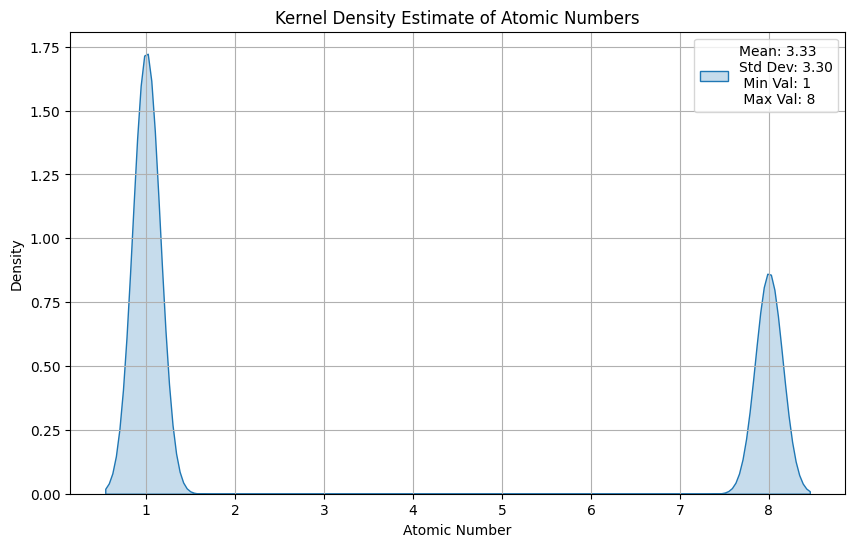

In [ ]:
# Original atoms distribution

atom = batch.atom_types.numpy()

mean_value = np.mean(atom)
std_deviation = np.std(atom)

plt.figure(figsize=(10, 6))
sns.kdeplot(atom, bw_adjust=0.5, fill=True)

plt.legend([f'Mean: {mean_value:.2f}\nStd Dev: {std_deviation:.2f}\n Min Val: {atom.min()}\n Max Val: {atom.max()}'])

plt.title('Kernel Density Estimate of Atomic Numbers')
plt.xlabel('Atomic Number')
plt.ylabel('Density')
plt.grid(True)
plt.show()

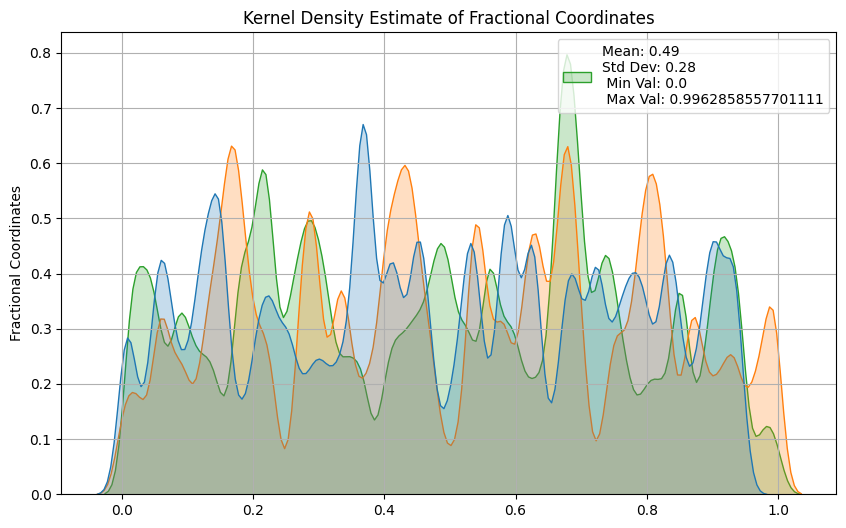

In [ ]:
# Original coords distribution

coord = batch.frac_coords.numpy()

mean_value = np.mean(coord)
std_deviation = np.std(coord)

plt.figure(figsize=(10, 6))
sns.kdeplot(coord, bw_adjust=0.5, fill=True)

plt.legend([f'Mean: {mean_value:.2f}\nStd Dev: {std_deviation:.2f}\n Min Val: {coord.min()}\n Max Val: {coord.max()}'])

plt.title('Kernel Density Estimate of Fractional Coordinates')
plt.xlabel('')
plt.ylabel('Fractional Coordinates')
plt.grid(True)
plt.show()

## Scaling Features

In [ ]:
# Create scalers for atoms and coordinates

atom_scaler = MinMaxPipeline(x_min=1, x_max=8, t_min=-1, t_max=1)
coord_scaler = MinMaxPipeline(x_min=0, x_max=1, t_min=-1, t_max=1)

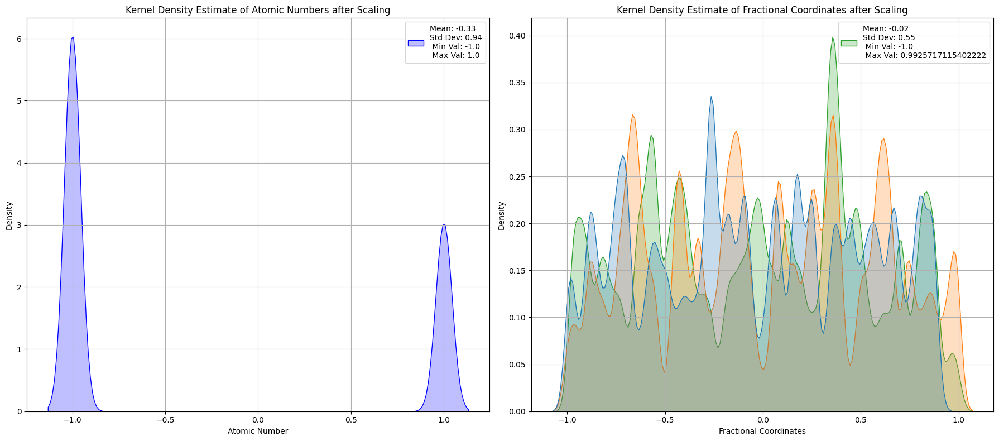

In [ ]:
# Visualize the distribution of scaled features before adding noise

atom = atom_scaler.scaler(batch.atom_types).numpy()
coord = coord_scaler.scaler(batch.frac_coords).numpy()

mean_atom = np.mean(atom)
std_atom = np.std(atom)
mean_coord = np.mean(coord)
std_coord = np.std(coord)

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.kdeplot(atom, bw_adjust=0.5, fill=True, ax=axes[0], color='blue')
axes[0].set_title('Kernel Density Estimate of Atomic Numbers after Scaling')
axes[0].set_xlabel('Atomic Number')
axes[0].set_ylabel('Density')
axes[0].legend([f'Mean: {mean_atom:.2f}\nStd Dev: {std_atom:.2f}\n Min Val: {atom.min()}\n Max Val: {atom.max()}'])
axes[0].grid(True)

sns.kdeplot(coord, bw_adjust=0.5, fill=True, ax=axes[1], color='orange')
axes[1].set_title('Kernel Density Estimate of Fractional Coordinates after Scaling')
axes[1].set_xlabel('Fractional Coordinates')
axes[1].set_ylabel('Density')
axes[1].legend([f'Mean: {mean_coord:.2f}\nStd Dev: {std_coord:.2f}\n Min Val: {coord.min()}\n Max Val: {coord.max()}'])
axes[1].grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# Function for adding noise to scaled features

def get_noisy_samples_from_batch(batch, noise_scheduler, device):
    bs = len(batch.num_atoms) # number of molecules in batch
    atom_scaled = atom_scaler.scaler(batch.atom_types.unsqueeze(1))
    coords_scaled = coord_scaler.scaler(batch.frac_coords)

    clean_nodes = torch.cat([coords_scaled, atom_scaled], dim=-1)
    # Sample noise to add to the images
    noise_nodes_frac_coords = torch.rand(coords_scaled.shape).to(device) # (num_atoms, frac_coords)
    noise_nodes_atom_type = torch.rand(atom_scaled.shape).to(device) # (num_atoms, atom_type)
    noise_nodes = torch.cat([noise_nodes_frac_coords, noise_nodes_atom_type], dim=-1) # (num_atoms, frac_coords+atom_type)

    # Sample a random timestep for each graph in the batch
    timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (bs,), device=device).long()

    # Add noise to the data according to the noise magnitude at each timestep (forward diffusion process)
    # Note: for the nodes we project the timesteps list to .batch (tensor indicating to which graph each node belongs)
    noisy_nodes = noise_scheduler.add_noise(clean_nodes, noise_nodes, timesteps[batch.batch])

    return noisy_nodes, noise_nodes, timesteps

batch = next(iter(datamodule.train_dataloader()))
noise_scheduler = DDPMScheduler(num_train_timesteps=100, beta_schedule='squaredcos_cap_v2')
noisy_nodes, noise_nodes, timesteps = get_noisy_samples_from_batch(batch, noise_scheduler, device='cpu')

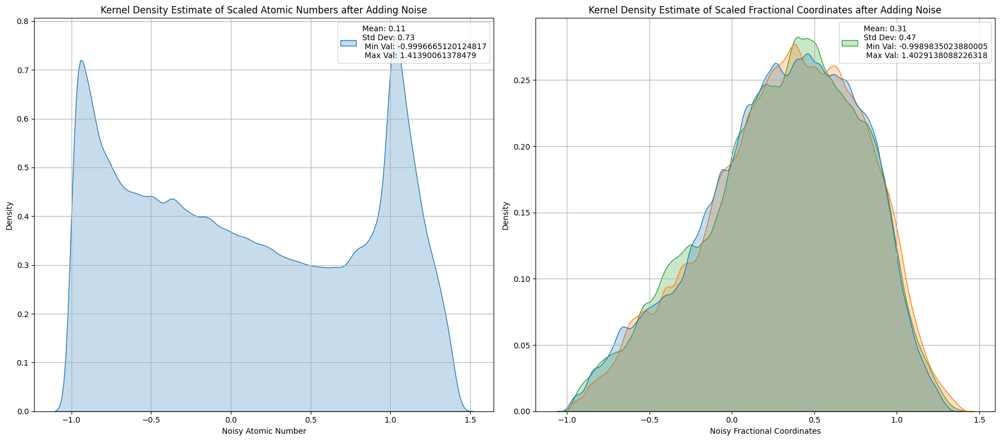

In [ ]:
# Display the distribution of scaled features after adding noise

noisy_atom = noisy_nodes[:, -1:].numpy()
noisy_coord = noisy_nodes[:, :-1].numpy()

mean_atom = np.mean(noisy_atom)
std_atom = np.std(noisy_atom)
mean_coord = np.mean(noisy_coord)
std_coord = np.std(noisy_coord)

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.kdeplot(noisy_atom, bw_adjust=0.5, fill=True, ax=axes[0], color='blue')
axes[0].set_title('Kernel Density Estimate of Scaled Atomic Numbers after Adding Noise')
axes[0].set_xlabel('Noisy Atomic Number')
axes[0].set_ylabel('Density')
axes[0].legend([f'Mean: {mean_atom:.2f}\nStd Dev: {std_atom:.2f}\n Min Val: {noisy_atom.min()}\n Max Val: {noisy_atom.max()}'])
axes[0].grid(True)

sns.kdeplot(noisy_coord, bw_adjust=0.5, fill=True, ax=axes[1], color='orange')
axes[1].set_title('Kernel Density Estimate of Scaled Fractional Coordinates after Adding Noise')
axes[1].set_xlabel('Noisy Fractional Coordinates')
axes[1].set_ylabel('Density')
axes[1].legend([f'Mean: {mean_coord:.2f}\nStd Dev: {std_coord:.2f}\n Min Val: {noisy_coord.min()}\n Max Val: {noisy_coord.max()}'])
axes[1].grid(True)

plt.tight_layout()
plt.show()

Epoch 0:   0%|          | 0/10 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
Epoch 99: 100%|██████████| 10/10 [00:02<00:00,  4.49it/s, loss_nodes=0.15, loss_nodes_atom=0.0905, loss_nodes_coords=0.17, lr=0, r2_train=-1.52, step=999]
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


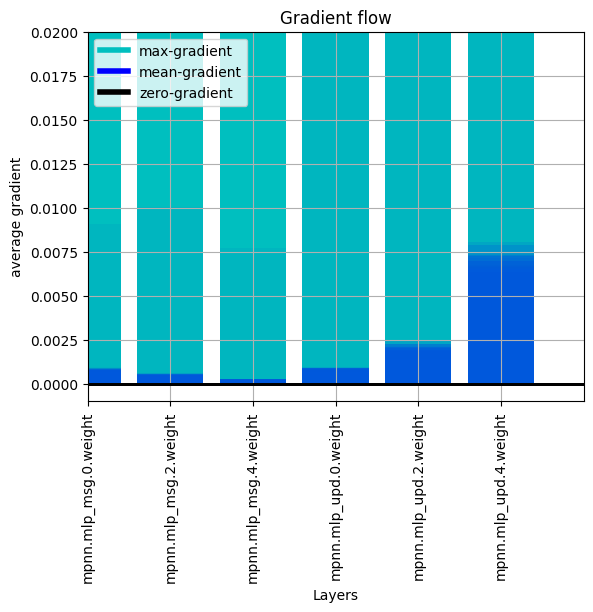

In [ ]:
# Training process

model = GNN_mp_model(coord_dim=3, atom_type_dim=1, time_step_dim=1)

noise_scheduler = DDPMScheduler(num_train_timesteps=100, beta_schedule='squaredcos_cap_v2')
optimizer = torch.optim.Adam(model.parameters(), lr=config.learning_rate, weight_decay=0)
lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=config.lr_warmup_steps,
    num_training_steps=(len(datamodule.train_dataloader()) * config.num_epochs))

device = 'cuda' if torch.cuda.is_available() else 'cpu'

accelerator, logs, models = train_loop(config, model, noise_scheduler, optimizer,
                                datamodule.train_dataloader(), datamodule.val_dataloader()[0],
                               lr_scheduler, device )

In [ ]:
# Training results

%load_ext tensorboard
%tensorboard --logdir scaling/logs

<IPython.core.display.Javascript object>

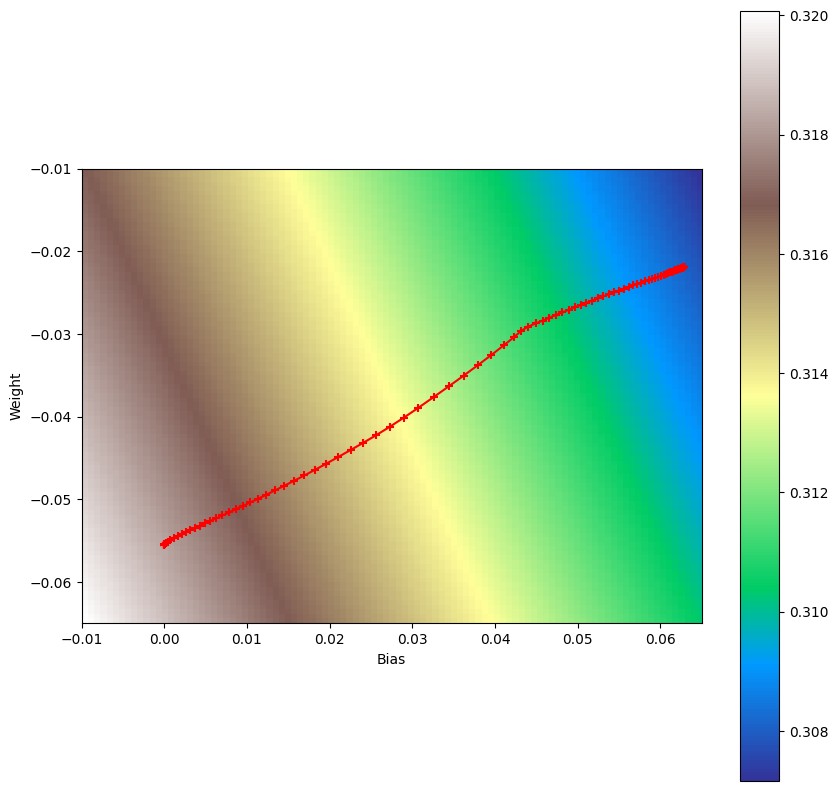

In [ ]:
# Visualize the gradient descent

def get_loss_map(loss_fn, x, y):
    losses = [[0.0] * 101 for _ in range(101)]
    for wi in range(101):
        for wb in range(101):
            w = 0.065 + 0.01 * wi / 100
            b = -0.01 + 0.01 * wb / 100
            ywb = x * w + b
            losses[wi][wb] = loss_fn(ywb, y).item()
    return list(reversed(losses))

x, y = noisy_nodes, noise_nodes
loss_fn = torch.nn.MSELoss()
losses = get_loss_map(loss_fn, x, y)

figsize = (10, 10)  # Size of the figure in inches (width, height)
dpi = 100  # Dots per inch

fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
plt.xlabel('Bias')
plt.ylabel('Weight')

extent = [-0.01, 0.065, -0.065, -0.01]
i = ax.imshow(losses, cmap=pylab.get_cmap('terrain'), interpolation='nearest', extent=extent)

ax.set_xlim(extent[0], extent[1])
ax.set_ylim(extent[2], extent[3])

model_weights, model_biases = zip(*models)
ax.scatter(model_biases, model_weights, c='r', marker='+')
ax.plot(model_biases, model_weights, c='r')

fig.colorbar(i)
plt.gca().set_aspect('equal', adjustable='box')
plt.show()


In [ ]:
# Generated samples

@dataclass
class EvaluateConfig(ConfigBase):
    eval_batch_size: int = 1
    num_epochs: int = 420
    gradient_accumulation_steps: int = 1
    learning_rate: float = 0.022
    lr_warmup_steps: int = 374
    save_model_epochs: int = 10
    mixed_precision: str = "no"
    output_dir = "scaling"
    model_dir = "/scaling/logs/checkpoints/checkpoint_9"

    # dataset used for training configuration
    dataset_name: str = "mp-20"
    dataset_path = "/content/val_gro.pt"
    dataset_property_conditional: str = "formation_energy_per_atom"
    niggli: bool = True
    primitive: bool = False
    graph_method: str = "crystalnn"
    preprocess_workers: int = 4
    lattice_scale_method: str = "scale_length"

config = EvaluateConfig()

model = model
model.load_state_dict(torch.load("/content/scaling/model_state_dict.pt"))
noise_scheduler = DDPMScheduler.from_pretrained(config.output_dir)

@torch.no_grad()
def evaluate(config, scheduler, model, dataloader_ev, device, path_to_save="./"):
    if path_to_save is not None:
        os.makedirs(path_to_save, exist_ok=True)

    model.to(device)
    model.eval()
    for step, batch_ev in enumerate(dataloader_ev):
        batch_ev = batch_ev.to(device)  # Move batch to the correct device
        num_atoms = batch_ev.num_atoms.item()
        scheduler.set_timesteps(scheduler.config.num_train_timesteps)
        atom = torch.rand(num_atoms, 1).to(device)
        coords = torch.rand(num_atoms, 3).to(device)
        nodes = torch.cat([coords, atom], dim=1).to(device)  # (num_atoms, frac_coords + atom_type)

        for t in scheduler.timesteps:
            t = t.to(device)  # Ensure timesteps are on the correct device
            noise_nodes = model(nodes, batch_ev, t.unsqueeze(-1))
            nodes = scheduler.step(noise_nodes, t, nodes)["prev_sample"]

        generated_crystal_info = {
            'num_atoms': num_atoms,
            'frac_coords': coord_scaler.reverse_scaler(nodes[:, :3]),
            'atom_types': atom_scaler.reverse_scaler(nodes[:, -1]).int(),
        }

        torch.save(generated_crystal_info, os.path.join(path_to_save, f"generated_crystal_{step}.pt"))

        print(t, step, batch_ev)
        print(f"Generated crystal info for step {step}: {generated_crystal_info}")

evaluate(config, noise_scheduler, model, datamodule_ev, 'cpu', path_to_save="/content/generated_water/")


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Output streaming troncato alle ultime 5000 righe.
        [5.3730e-01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 5.4641e-01, 2.3751e-02],
        [9.9243e-01, 4.4971e-01, 5.4678e-01],
        [0.0000e+00, 9.5890e-03, 1.1599e-02],
        [5.2324e-01, 1.0354e-01, 4.1281e-01],
        [9.8735e-01, 3.7776e-02, 3.3027e-01],
        [2.6699e-01, 1.5180e-02, 3.7335e-01],
        [3.1374e-01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.2488e-01, 0.0000e+00],
        [7.7044e-01, 1.0000e+00, 9.0078e-01],
        [2.7634e-01, 1.1684e-01, 5.7565e-01],
        [7.9205e-01, 9.6529e-01, 1.9901e-01],
        [1.0915e-01, 6.1826e-01, 0.0000e+00],
        [3.1653e-01, 2.7752e-01, 2.5653e-01],
        [4.3988e-01, 2.8627e-01, 0.0000e+00],
        [3.8609e-02, 9.9265e-01, 7.2093e-01],
        [5.7542e-01, 6.5811e-02, 4.7526e-01],
        [0.0000e+00, 8.2573e-01, 7.0644e-01],
        [0.0000e+00, 7.0058e-01, 8.2382e-01],
        [5.1334e-01, 7.1726e-02, 7.8001e-01],
        [2.2255e-01, 2.6245e-0

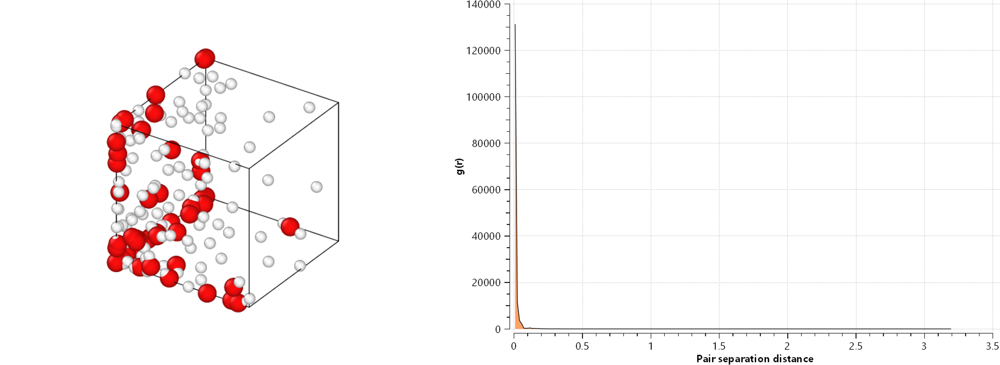

## Scaling Noise


In [ ]:
# Create scaler for the noise

noise_scaler = MinMaxPipeline(x_min=0, x_max=1, t_min=-1, t_max=1)

In [ ]:
# Create noisy samples

def get_noisy_samples_from_batch(batch, noise_scheduler, device):
    bs = len(batch.num_atoms) # number of molecules in batch

    atom = batch.atom_types.unsqueeze(1)
    coords = batch.frac_coords
    clean_nodes = torch.cat([coords, atom], dim=-1)

    noise_nodes_frac_coords = noise_scaler.scaler(torch.rand(coords.shape)).to(device) # (num_atoms, frac_coords)
    noise_nodes_atom_type = noise_scaler.scaler(torch.rand(atom.shape)).to(device) # (num_atoms, atom_type)
    noise_nodes = torch.cat([noise_nodes_frac_coords, noise_nodes_atom_type], dim=-1) # (num_atoms, frac_coords+atom_type)

    # Sample a random timestep for each graph in the batch
    timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (bs,), device=device).long()

    # Add noise to the data according to the noise magnitude at each timestep (forward diffusion process)
    # Note: for the nodes we project the timesteps list to .batch (tensor indicating to which graph each node belongs)
    noisy_nodes = noise_scheduler.add_noise(clean_nodes, noise_nodes, timesteps[batch.batch])

    return noisy_nodes, noise_nodes, timesteps

batch = next(iter(datamodule.train_dataloader()))
noise_scheduler = DDPMScheduler(num_train_timesteps=100, beta_schedule='squaredcos_cap_v2')
noisy_nodes, noise_nodes, timesteps = get_noisy_samples_from_batch(batch, noise_scheduler, device='cpu')

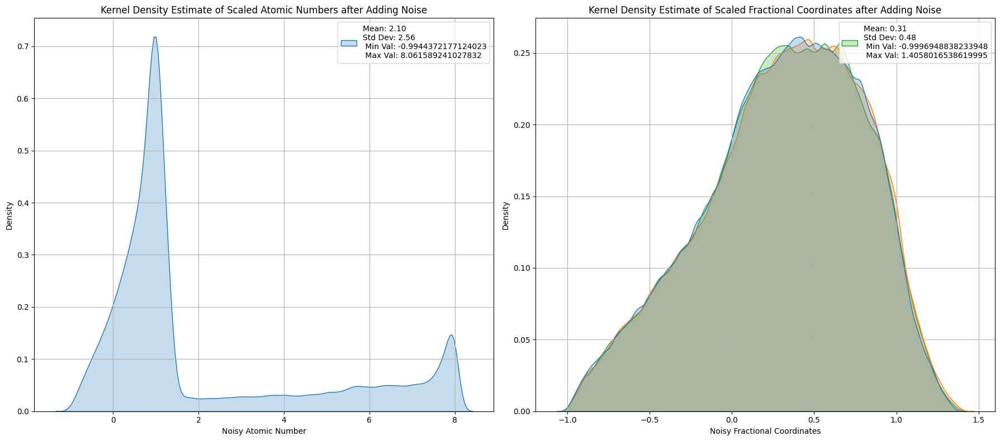

In [ ]:
# Visualize the samples after adding scaled noise

noisy_atom = noisy_nodes[:, -1:].numpy()
noisy_coord = noisy_nodes[:, :-1].numpy()

mean_atom = np.mean(noisy_atom)
std_atom = np.std(noisy_atom)
mean_coord = np.mean(noisy_coord)
std_coord = np.std(noisy_coord)

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.kdeplot(noisy_atom, bw_adjust=0.5, fill=True, ax=axes[0], color='blue')
axes[0].set_title('Kernel Density Estimate of Scaled Atomic Numbers after Adding Noise')
axes[0].set_xlabel('Noisy Atomic Number')
axes[0].set_ylabel('Density')
axes[0].legend([f'Mean: {mean_atom:.2f}\nStd Dev: {std_atom:.2f}\n Min Val: {noisy_atom.min()}\n Max Val: {noisy_atom.max()}'])
axes[0].grid(True)

sns.kdeplot(noisy_coord, bw_adjust=0.5, fill=True, ax=axes[1], color='orange')
axes[1].set_title('Kernel Density Estimate of Scaled Fractional Coordinates after Adding Noise')
axes[1].set_xlabel('Noisy Fractional Coordinates')
axes[1].set_ylabel('Density')
axes[1].legend([f'Mean: {mean_coord:.2f}\nStd Dev: {std_coord:.2f}\n Min Val: {noisy_coord.min()}\n Max Val: {noisy_coord.max()}'])
axes[1].grid(True)

plt.tight_layout()
plt.show()

Epoch 0:   0%|          | 0/10 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
Epoch 99: 100%|██████████| 10/10 [00:01<00:00,  6.89it/s, loss_nodes=0.321, loss_nodes_atom=0.324, loss_nodes_coords=0.32, lr=0, r2_train=-0.0799, step=999]
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


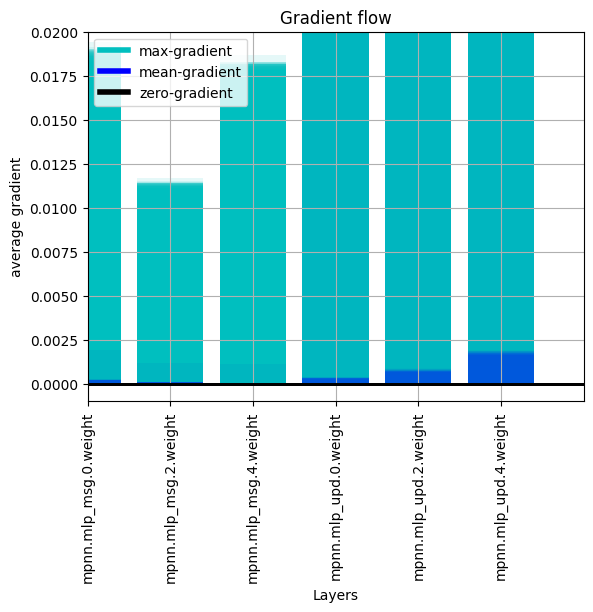

In [ ]:
# Training process

model = GNN_mp_model(coord_dim=3, atom_type_dim=1, time_step_dim=1)

noise_scheduler = DDPMScheduler(num_train_timesteps=100, beta_schedule='squaredcos_cap_v2')
optimizer = torch.optim.Adam(model.parameters(), lr=config.learning_rate, weight_decay=0)
lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=config.lr_warmup_steps,
    num_training_steps=(len(datamodule.train_dataloader()) * config.num_epochs))

device = 'cuda' if torch.cuda.is_available() else 'cpu'

accelerator, logs, models = train_loop(config, model, noise_scheduler, optimizer,
                                datamodule.train_dataloader(), datamodule.val_dataloader()[0],
                               lr_scheduler, device )

In [ ]:
# Training results

%load_ext tensorboard
%tensorboard --logdir scaling/logs

<IPython.core.display.Javascript object>

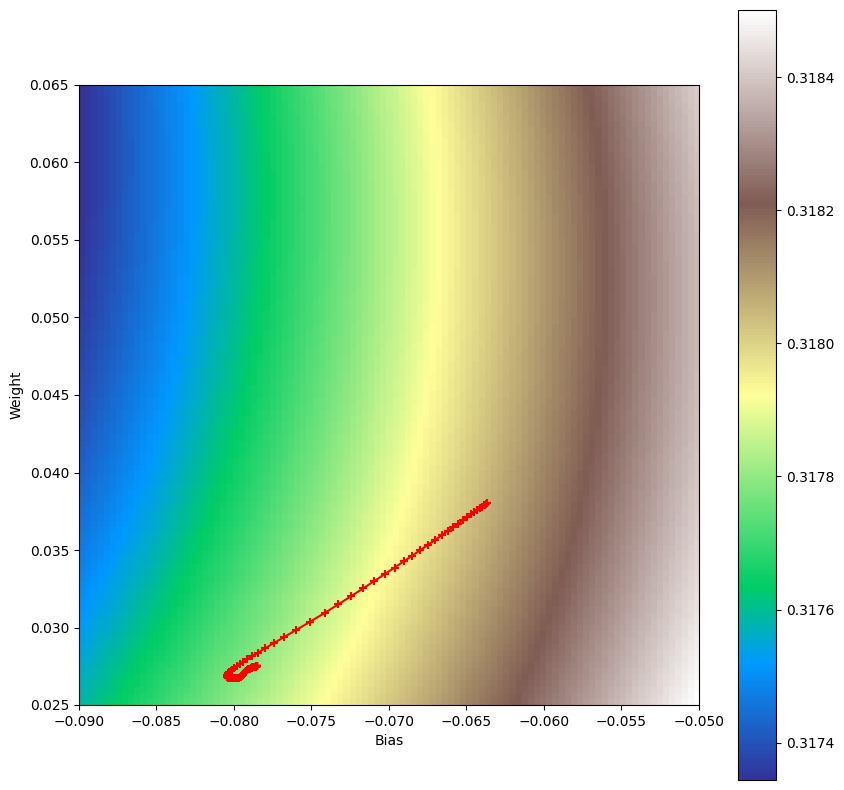

In [ ]:
# Visualize the gradient descent

def get_loss_map(loss_fn, x, y):
    losses = [[0.0] * 101 for _ in range(101)]
    for wi in range(101):
        for wb in range(101):
            w = 0.065 + 0.01 * wi / 100
            b = -0.01 + 0.01 * wb / 100
            ywb = x * w + b
            losses[wi][wb] = loss_fn(ywb, y).item()
    return list(reversed(losses))

x, y = noisy_nodes, noise_nodes
loss_fn = torch.nn.MSELoss()
losses = get_loss_map(loss_fn, x, y)

figsize = (10, 10)  # Size of the figure in inches (width, height)
dpi = 100  # Dots per inch

fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
plt.xlabel('Bias')
plt.ylabel('Weight')

extent = [-0.09, -0.05, 0.025, 0.065]
i = ax.imshow(losses, cmap=pylab.get_cmap('terrain'), interpolation='nearest', extent=extent)

ax.set_xlim(extent[0], extent[1])
ax.set_ylim(extent[2], extent[3])

model_weights, model_biases = zip(*models)
ax.scatter(model_biases, model_weights, c='r', marker='+')
ax.plot(model_biases, model_weights, c='r')

fig.colorbar(i)
plt.gca().set_aspect('equal', adjustable='box')
plt.show()


In [ ]:
# Generate the samples

@dataclass
class EvaluateConfig(ConfigBase):
    eval_batch_size: int = 1
    num_epochs: int = 420
    gradient_accumulation_steps: int = 1
    learning_rate: float = 0.022
    lr_warmup_steps: int = 374
    save_model_epochs: int = 10
    mixed_precision: str = "no"
    output_dir = "scaling"
    model_dir = "/scaling/logs/checkpoints/checkpoint_9"

    # dataset used for training configuration
    dataset_name: str = "mp-20"
    dataset_path = "/content/val_gro.pt"
    dataset_property_conditional: str = "formation_energy_per_atom"
    niggli: bool = True
    primitive: bool = False
    graph_method: str = "crystalnn"
    preprocess_workers: int = 4
    lattice_scale_method: str = "scale_length"

config = EvaluateConfig()

model = model
model.load_state_dict(torch.load("/content/scaling/model_state_dict.pt"))
noise_scheduler = DDPMScheduler.from_pretrained(config.output_dir)

@torch.no_grad()
def evaluate(config, scheduler, model, dataloader_ev, device, path_to_save="./"):
    if path_to_save is not None:
        os.makedirs(path_to_save, exist_ok=True)

    model.to(device)
    model.eval()
    for step, batch_ev in enumerate(dataloader_ev):
        batch_ev = batch_ev.to(device)  # Move batch to the correct device
        num_atoms = batch_ev.num_atoms.item()

        scheduler.set_timesteps(scheduler.config.num_train_timesteps)
        atom = torch.rand(num_atoms, 1).to(device)
        coords = torch.rand((num_atoms, 3)).to(device)
        nodes = noise_scaler.scaler(torch.cat([coords, atom], dim=1)).to(device)

        for t in scheduler.timesteps:
            t = t.to(device)  # Ensure timesteps are on the correct device
            noise_nodes = model(nodes, batch_ev, t.unsqueeze(-1))
            nodes = scheduler.step(noise_nodes, t, nodes)["prev_sample"]

        generated_crystal_info = {
            'num_atoms': num_atoms,
            'frac_coords': (nodes[:, :3]),
            'atom_types': (nodes[:, -1]).int(),
        }

        torch.save(generated_crystal_info, os.path.join(path_to_save, f"generated_crystal_{step}.pt"))

        print(t, step, batch_ev)
        print(f"Generated crystal info for step {step}: {generated_crystal_info}")

evaluate(config, noise_scheduler, model, datamodule_ev, 'cpu', path_to_save="/content/generated_water/")


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Output streaming troncato alle ultime 5000 righe.
        [ 9.5022e-01, -7.7248e-01, -7.3191e-01],
        [ 8.3317e-01,  9.8703e-01,  9.2405e-01],
        [ 1.0000e+00, -2.9219e-02, -1.0000e+00],
        [ 6.9815e-01,  6.8041e-01,  8.4790e-01],
        [ 4.8506e-01,  1.0000e+00, -9.7505e-01],
        [-8.4042e-01,  9.7411e-01, -4.0616e-01],
        [ 1.0000e+00,  1.0000e+00, -1.0000e+00],
        [ 9.2072e-01, -6.5571e-01,  7.6840e-01],
        [-8.1178e-01,  8.4010e-01, -2.5717e-01],
        [-2.7032e-01,  4.1495e-01, -1.0000e+00],
        [ 4.5451e-01,  8.3662e-01, -2.2800e-02],
        [-5.9625e-02,  1.9340e-01, -4.5916e-01],
        [ 2.1688e-01,  1.5057e-01, -1.0000e+00],
        [ 9.6346e-01, -7.9978e-01, -7.2993e-01],
        [ 9.7911e-01,  8.6373e-01, -9.8144e-01],
        [-7.7372e-01, -5.2069e-01, -8.2738e-01],
        [-8.5750e-01,  8.3794e-01, -1.4190e-01],
        [-9.6444e-01, -2.4006e-01,  9.2708e-01],
        [-8.0244e-01, -3.4050e-01, -1.7332e-01],
        [ 9.3762e-0

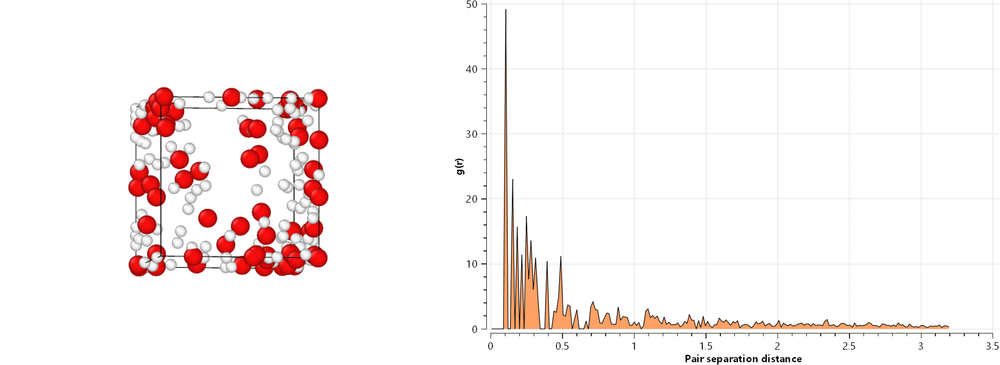

## Scaling Both

In [ ]:
# Create the scalers for the noise and for the features

atom_scaler = MinMaxPipeline(x_min=1, x_max=8, t_min=-1, t_max=1)
coord_scaler = MinMaxPipeline(x_min=0, x_max=1, t_min=-1, t_max=1)
noise_scaler = MinMaxPipeline(x_min=0, x_max=1, t_min=-1, t_max=1)

In [ ]:
# Visualize the distribution of scaled features before adding noise

atom = atom_scaler.scaler(batch.atom_types).numpy()
coord = coord_scaler.scaler(batch.frac_coords).numpy()

mean_atom = np.mean(atom)
std_atom = np.std(atom)
mean_coord = np.mean(coord)
std_coord = np.std(coord)

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.kdeplot(atom, bw_adjust=0.5, fill=True, ax=axes[0], color='blue')
axes[0].set_title('Kernel Density Estimate of Atomic Numbers after Scaling')
axes[0].set_xlabel('Atomic Number')
axes[0].set_ylabel('Density')
axes[0].legend([f'Mean: {mean_atom:.2f}\nStd Dev: {std_atom:.2f}\n Min Val: {atom.min()}\n Max Val: {atom.max()}'])
axes[0].grid(True)

sns.kdeplot(coord, bw_adjust=0.5, fill=True, ax=axes[1], color='orange')
axes[1].set_title('Kernel Density Estimate of Fractional Coordinates after Scaling')
axes[1].set_xlabel('Fractional Coordinates')
axes[1].set_ylabel('Density')
axes[1].legend([f'Mean: {mean_coord:.2f}\nStd Dev: {std_coord:.2f}\n Min Val: {coord.min()}\n Max Val: {coord.max()}'])
axes[1].grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# Function to add scaled noise

def get_noisy_samples_from_batch(batch, noise_scheduler, device):
    bs = len(batch.num_atoms) # number of molecules in batch

    atom_scaled = atom_scaler.scaler(batch.atom_types.unsqueeze(1))
    coords_scaled = coord_scaler.scaler(batch.frac_coords)
    clean_nodes = torch.cat([coords_scaled, atom_scaled], dim=-1)

    noise_nodes_frac_coords = noise_scaler.scaler(torch.rand(coords_scaled.shape)).to(device) # (num_atoms, frac_coords)
    noise_nodes_atom_type = noise_scaler.scaler(torch.rand(atom_scaled.shape)).to(device) # (num_atoms, atom_type)
    noise_nodes = torch.cat([noise_nodes_frac_coords, noise_nodes_atom_type], dim=-1) # (num_atoms, frac_coords+atom_type)

    # Sample a random timestep for each graph in the batch
    timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (bs,), device=device).long()

    # Add noise to the data according to the noise magnitude at each timestep (forward diffusion process)
    # Note: for the nodes we project the timesteps list to .batch (tensor indicating to which graph each node belongs)
    noisy_nodes = noise_scheduler.add_noise(clean_nodes, noise_nodes, timesteps[batch.batch])

    return noisy_nodes, noise_nodes, timesteps

batch = next(iter(datamodule.train_dataloader()))
noise_scheduler = DDPMScheduler(num_train_timesteps=100, beta_schedule='squaredcos_cap_v2')
noisy_nodes, noise_nodes, timesteps = get_noisy_samples_from_batch(batch, noise_scheduler, device='cpu')

In [ ]:
# Visualize the distribution of scaled features after adding scaled noise

noisy_atom = noisy_nodes[:, -1:].numpy()
noisy_coord = noisy_nodes[:, :-1].numpy()

mean_atom = np.mean(noisy_atom)
std_atom = np.std(noisy_atom)
mean_coord = np.mean(noisy_coord)
std_coord = np.std(noisy_coord)

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.kdeplot(noisy_atom, bw_adjust=0.5, fill=True, ax=axes[0], color='blue')
axes[0].set_title('Kernel Density Estimate of Scaled Atomic Numbers after Adding Noise')
axes[0].set_xlabel('Noisy Atomic Number')
axes[0].set_ylabel('Density')
axes[0].legend([f'Mean: {mean_atom:.2f}\nStd Dev: {std_atom:.2f}\n Min Val: {noisy_atom.min()}\n Max Val: {noisy_atom.max()}'])
axes[0].grid(True)

sns.kdeplot(noisy_coord, bw_adjust=0.5, fill=True, ax=axes[1], color='orange')
axes[1].set_title('Kernel Density Estimate of Scaled Fractional Coordinates after Adding Noise')
axes[1].set_xlabel('Noisy Fractional Coordinates')
axes[1].set_ylabel('Density')
axes[1].legend([f'Mean: {mean_coord:.2f}\nStd Dev: {std_coord:.2f}\n Min Val: {noisy_coord.min()}\n Max Val: {noisy_coord.max()}'])
axes[1].grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# Training process

model = GNN_mp_model(coord_dim=3, atom_type_dim=1, time_step_dim=1)

noise_scheduler = DDPMScheduler(num_train_timesteps=100, beta_schedule='squaredcos_cap_v2')
optimizer = torch.optim.Adam(model.parameters(), lr=config.learning_rate, weight_decay=0)
lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=config.lr_warmup_steps,
    num_training_steps=(len(datamodule.train_dataloader()) * config.num_epochs))

device = 'cuda' if torch.cuda.is_available() else 'cpu'

accelerator, logs, models = train_loop(config, model, noise_scheduler, optimizer,
                                datamodule.train_dataloader(), datamodule.val_dataloader()[0],
                               lr_scheduler, device )

In [ ]:
# Training results

%load_ext tensorboard
%tensorboard --logdir scaling/logs

In [ ]:
# Visualize the gradient descent

def get_loss_map(loss_fn, x, y):
    losses = [[0.0] * 101 for _ in range(101)]
    for wi in range(101):
        for wb in range(101):
            w = 0.065 + 0.01 * wi / 100
            b = -0.01 + 0.01 * wb / 100
            ywb = x * w + b
            losses[wi][wb] = loss_fn(ywb, y).item()
    return list(reversed(losses))

x, y = noisy_nodes, noise_nodes
loss_fn = torch.nn.MSELoss()
losses = get_loss_map(loss_fn, x, y)

figsize = (10, 10)  # Size of the figure in inches (width, height)
dpi = 100  # Dots per inch

fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
plt.xlabel('Bias')
plt.ylabel('Weight')

extent = [-0.09, -0.05, 0.025, 0.065]
i = ax.imshow(losses, cmap=pylab.get_cmap('terrain'), interpolation='nearest', extent=extent)

ax.set_xlim(extent[0], extent[1])
ax.set_ylim(extent[2], extent[3])

model_weights, model_biases = zip(*models)
ax.scatter(model_biases, model_weights, c='r', marker='+')
ax.plot(model_biases, model_weights, c='r')

fig.colorbar(i)
plt.gca().set_aspect('equal', adjustable='box')
plt.show()


In [ ]:
@dataclass
class EvaluateConfig(ConfigBase):
    eval_batch_size: int = 1
    num_epochs: int = 420
    gradient_accumulation_steps: int = 1
    learning_rate: float = 0.022
    lr_warmup_steps: int = 374
    save_model_epochs: int = 10
    mixed_precision: str = "no"
    output_dir = "scaling"
    model_dir = "/scaling/logs/checkpoints/checkpoint_9"

    # dataset used for training configuration
    dataset_name: str = "mp-20"
    dataset_path = "/content/val_gro.pt"
    dataset_property_conditional: str = "formation_energy_per_atom"
    niggli: bool = True
    primitive: bool = False
    graph_method: str = "crystalnn"
    preprocess_workers: int = 4
    lattice_scale_method: str = "scale_length"

config = EvaluateConfig()

model = model
model.load_state_dict(torch.load("/content/scaling/model_state_dict.pt"))
noise_scheduler = DDPMScheduler.from_pretrained(config.output_dir)

@torch.no_grad()
def evaluate(config, scheduler, model, dataloader_ev, device, path_to_save="./"):
    if path_to_save is not None:
        os.makedirs(path_to_save, exist_ok=True)

    model.to(device)
    model.eval()
    for step, batch_ev in enumerate(dataloader_ev):
        batch_ev = batch_ev.to(device)  # Move batch to the correct device
        num_atoms = batch_ev.num_atoms.item()
        scheduler.set_timesteps(scheduler.config.num_train_timesteps)
        atom = torch.rand(num_atoms, 1).to(device)
        coords = torch.rand(num_atoms, 3).to(device)
        nodes = noise_scaler.scaler(torch.cat([coords, atom], dim=1)).to(device)  # (num_atoms, frac_coords + atom_type)

        for t in scheduler.timesteps:
            t = t.to(device)  # Ensure timesteps are on the correct device
            noise_nodes = model(nodes, batch_ev, t.unsqueeze(-1))
            nodes = scheduler.step(noise_nodes, t, nodes)["prev_sample"]

        generated_crystal_info = {
            'num_atoms': num_atoms,
            'frac_coords': coord_scaler.reverse_scaler(nodes[:, :3]),
            'atom_types': atom_scaler.reverse_scaler(nodes[:, -1]).int(),
        }

        torch.save(generated_crystal_info, os.path.join(path_to_save, f"generated_crystal_{step}.pt"))

        print(t, step, batch_ev)
        print(f"Generated crystal info for step {step}: {generated_crystal_info}")

evaluate(config, noise_scheduler, model, datamodule_ev, 'cpu', path_to_save="/content/generated_water/")


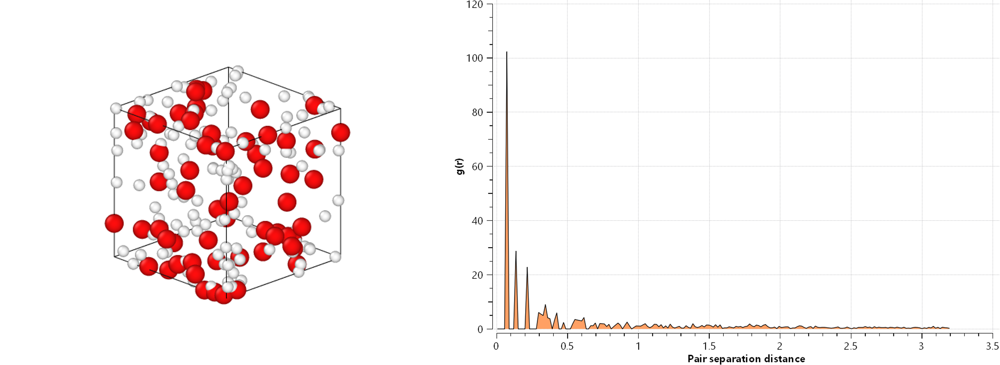